## Color Mapping

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

In [2]:
img = cv2.imread('DATA/00-puppy.jpg')

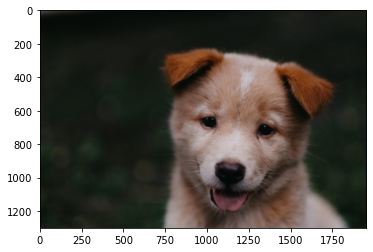

In [3]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)

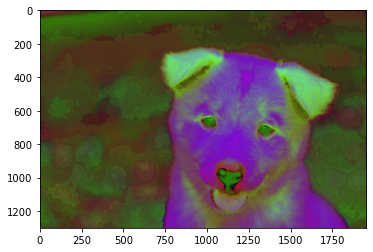

In [4]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
plt.imshow(img)

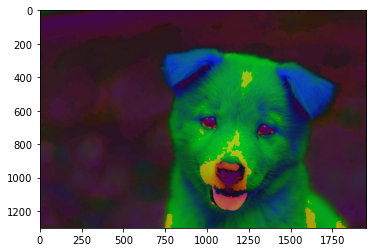

In [5]:
img = cv2.imread('DATA/00-puppy.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
plt.imshow(img)

## Blending and Pasting Images

In [6]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

In [7]:
# Two images
img1 = cv2.imread('DATA/dog_backpack.png')
img2 = cv2.imread('DATA/watermark_no_copy.png')

In [8]:
img1.shape

(1401, 934, 3)

In [9]:
img2.shape

(1280, 1277, 3)

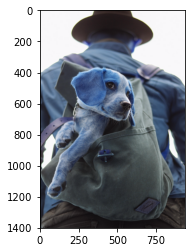

In [10]:
plt.imshow(img1)

In [11]:
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

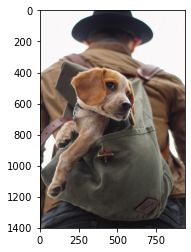

In [12]:
plt.imshow(img1)

In [13]:
img1.shape

(1401, 934, 3)

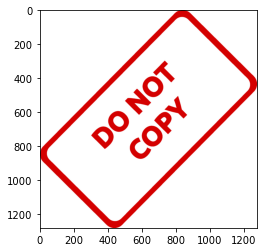

In [14]:
plt.imshow(img2)

In [15]:
img2.shape

(1280, 1277, 3)

### Blending Images of the Same Size

In [16]:
img1 =cv2.resize(img1,(1200,1200))
img2 =cv2.resize(img2,(1200,1200))
# Resizing

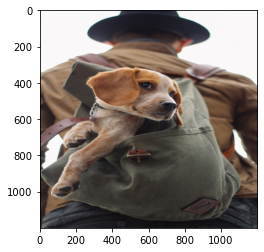

In [17]:
plt.imshow(img1)

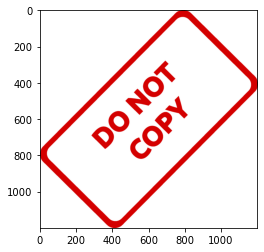

In [18]:
plt.imshow(img2)

### Blending the Image

In [19]:
img1.shape

(1200, 1200, 3)

In [20]:
img2.shape

(1200, 1200, 3)

In [21]:
blended = cv2.addWeighted(src1=img1,alpha=0.7,src2=img2,beta=0.3,gamma=0)
# src1 == 1st image
# alpha == how intense the first image
# src2 == 2nd image
# beta == how intense the second image
# need to be the same size

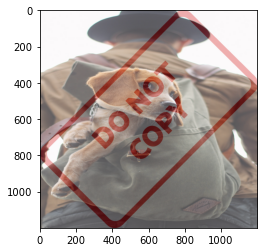

In [22]:
plt.imshow(blended)

In [23]:
blended = cv2.addWeighted(src1=img1,alpha=0.5,src2=img2,beta=0.5,gamma=0)
# src1 == 1st image
# alpha == how intense the first image
# src2 == 2nd image
# beta == how intense the second image
# need to be the same size

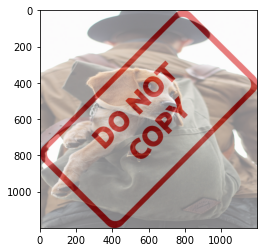

In [24]:
plt.imshow(blended)

### Overlaying Small Image On Top of a Larger Image (No Blending)

In [25]:
# Load two images
img1 = cv2.imread('DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

In [26]:
img2 =cv2.resize(img2,(600,600))

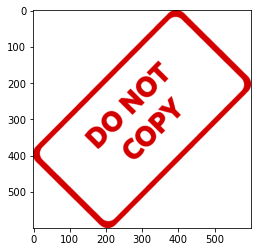

In [27]:
plt.imshow(img2)

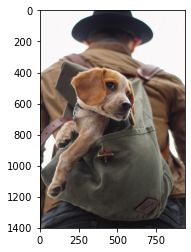

In [28]:
plt.imshow(img1)

In [29]:
large_img = img1
small_img = img2

In [30]:
x_offset=0
y_offset=0

In [31]:
x_end = x_offset + small_img.shape[1]
y_end = y_offset + small_img.shape[0]

In [32]:
large_img[y_offset:y_end, x_offset:x_end] = small_img

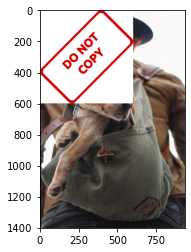

In [33]:
plt.imshow(large_img)

### Blend Together Images of Different Sizes

In [34]:
# Load two images
img1 = cv2.imread('DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

In [35]:
img2 =cv2.resize(img2,(600,600))

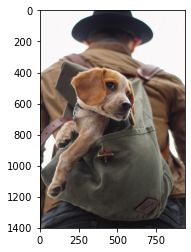

In [36]:
plt.imshow(img1)

In [37]:
img1.shape

(1401, 934, 3)

In [38]:
x_offset = 934 - 600  # height
y_offset = 1401 - 600  # width

In [39]:
img2.shape

(600, 600, 3)

In [40]:
rows,cols,channels = img2.shape

In [41]:
rows

600

In [42]:
cols

600

In [43]:
channels

3

In [44]:
roi = img1[y_offset:1401, x_offset:943]
# roi = region of interest

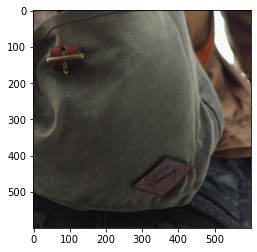

In [45]:
plt.imshow(roi)

In [46]:
img2gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

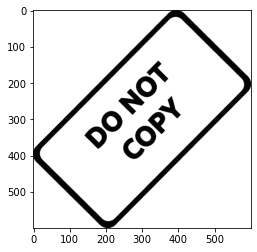

In [47]:
plt.imshow(img2gray, cmap='gray')

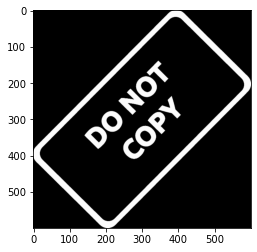

In [48]:
mask_inv = cv2.bitwise_not(img2gray)  # inverse
plt.imshow(mask_inv, cmap='gray')

In [49]:
mask_inv.shape  # notice it no longer contains color channel

(600, 600)

In [50]:
white_background = np.full(img2.shape, 255, dtype=np.uint8)
# image shape
# what you want it to be full of (in this case 255)
# integers

In [51]:
white_background

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [52]:
white_background.shape

(600, 600, 3)

In [53]:
bk = cv2.bitwise_or(white_background, white_background, mask=mask_inv)
# how it works: grab these two white backgrounds and put the mask on top of them

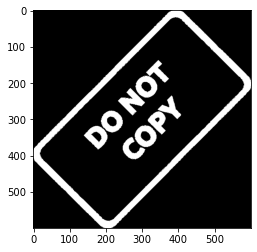

In [54]:
plt.imshow(bk)

In [55]:
fg = cv2.bitwise_or(img2, img2, mask=mask_inv)

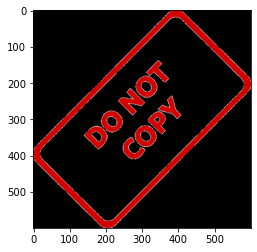

In [56]:
plt.imshow(fg)

In [57]:
final_roi = cv2.bitwise_or(roi, fg)

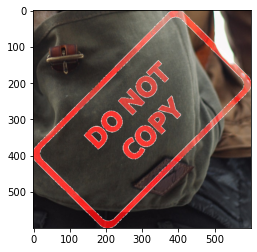

In [58]:
plt.imshow(final_roi)

In [59]:
large_img = img1
small_img = final_roi

In [60]:
large_img[y_offset:y_offset+small_img.shape[0], x_offset:x_offset+small_img.shape[1]] = small_img

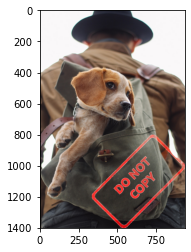

In [61]:
plt.imshow(large_img)

## Image Thresholding

In [62]:
import cv2
import matplotlib.pyplot as plt

In [63]:
img = cv2.imread('DATA/rainbow.jpg', 0)  # o for grayscale

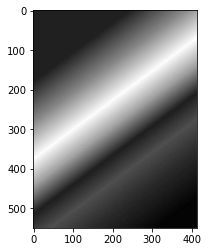

In [64]:
plt.imshow(img, cmap='gray')

In [65]:
255/2  # middle point

127.5

In [66]:
ret, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
# source image
# threshold
# max possible value
# THRESH_BINARY == anything below threshold is 0 while above threshold is 255

In [67]:
ret
# the actual value of the cut off

127.0

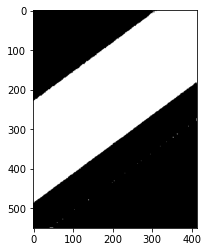

In [68]:
plt.imshow(thresh1, cmap='gray')

In [69]:
ret, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY_INV)
# source image
# threshold
# max possible value
# THRESH_BINARY_INV == same as THRESH_BINARY but inverse

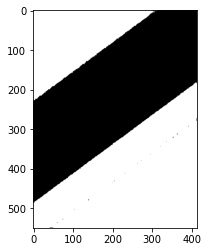

In [70]:
plt.imshow(thresh1, cmap='gray')

In [71]:
ret, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_TRUNC)
# source image
# threshold
# max possible value
# THRESH_TRUNC == if the value is larger than threshold it will bring the value back to threshold
# otherwise it will keep the original value

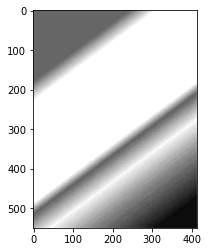

In [72]:
plt.imshow(thresh1, cmap='gray')

In [73]:
ret, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_TOZERO)
# source image
# threshold
# max possible value
# THRESH_TOZERO == if above threeshold keep the value, lower than threshold bring it back to 0

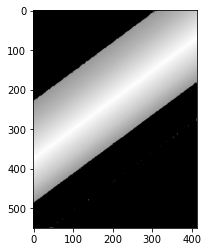

In [74]:
plt.imshow(thresh1, cmap='gray')

In [75]:
ret, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_TOZERO_INV)
# source image
# threshold
# max possible value
# THRESH_TOZERO_INV == same as THRESH_TOZERO but inverse

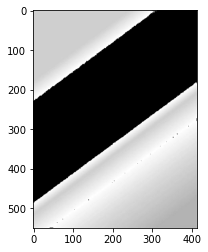

In [76]:
plt.imshow(thresh1, cmap='gray')

In [77]:
img = cv2.imread('DATA/crossword.jpg', 0)

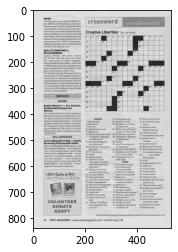

In [78]:
plt.imshow(img, cmap='gray')

In [79]:
def show_pic(img):
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap='gray')

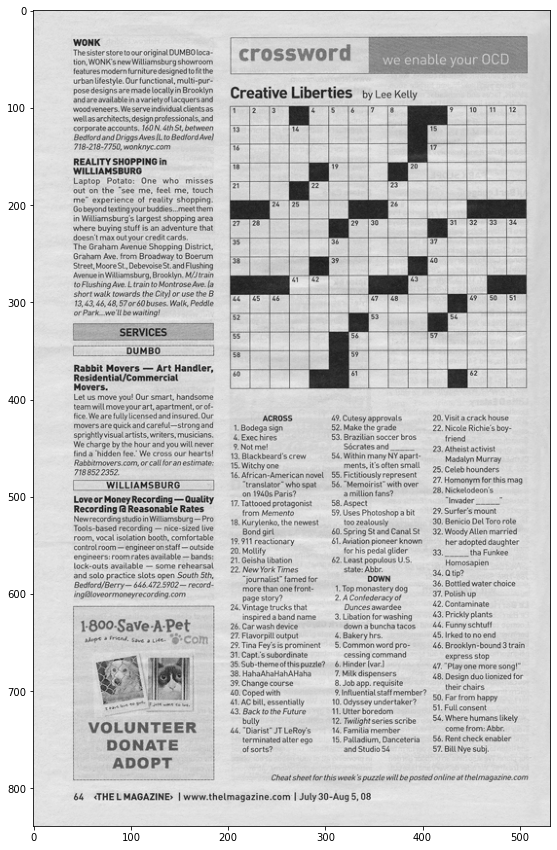

In [80]:
show_pic(img)

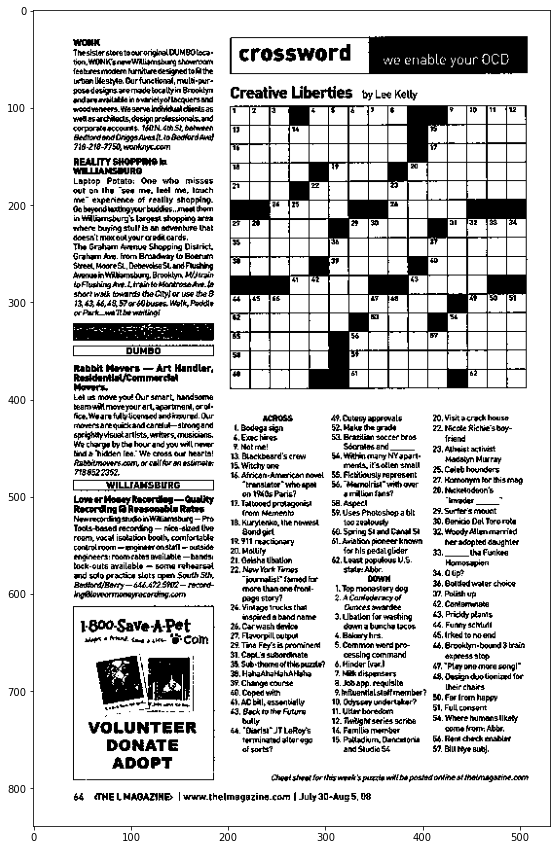

In [81]:
ret,th1 = cv2.threshold(img,180,255,cv2.THRESH_BINARY)
show_pic(th1)
# play around with the threshold

In [82]:
th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 8)
# source image 
# max value
# choose adaptive method (look ath the neigborhood around the pixel and see wether the pixel should be include)
# threshold type result after adaptive threshold
# block size == szie of picture neighborhood that is used to calculate the threshold for particular pixel (need to be ood number like 3,5,7,11)
# constant value substract from the mean or weighted mean, normally positive but can be negative as well (just play around with it)

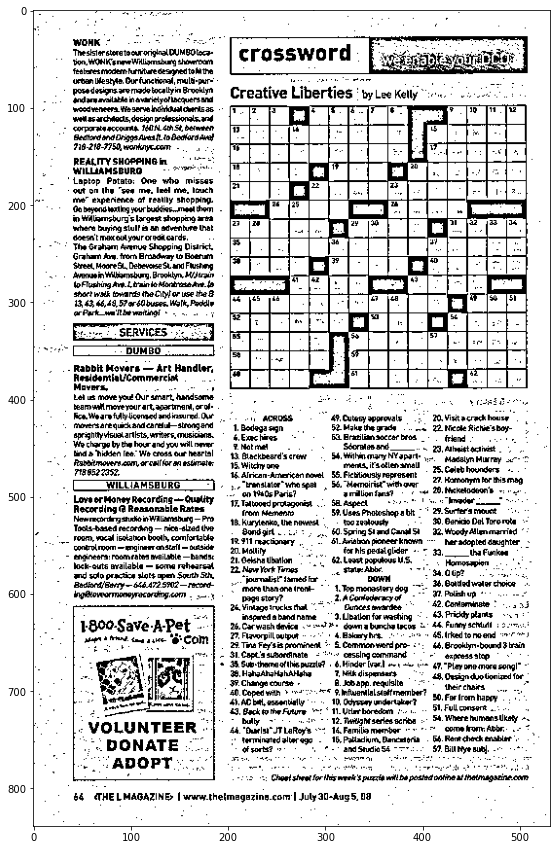

In [83]:
show_pic(th2)

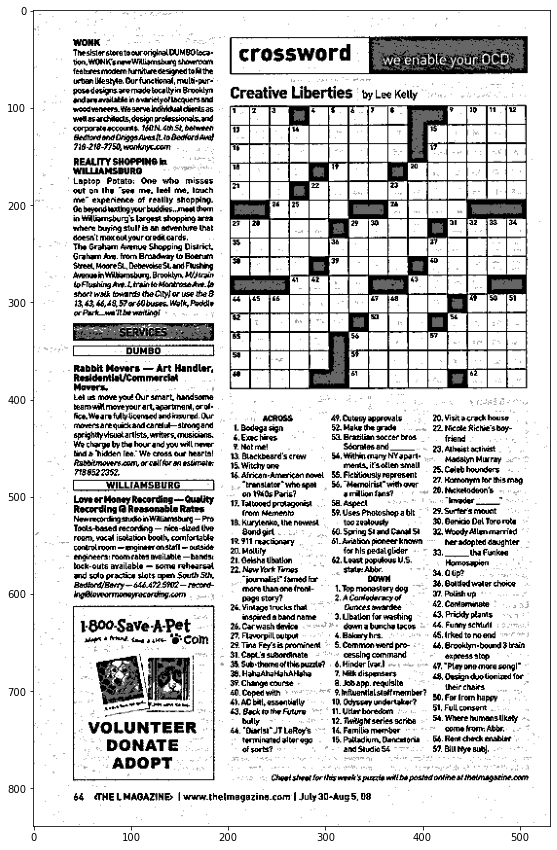

In [84]:
blended = cv2.addWeighted(src1=th1, alpha=0.6, src2=th2, beta=0.4, gamma=0)
show_pic(blended)

Normally people will just use adaptive method and just playing with it

In [85]:
th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 8)
# source image 
# max value
# choose adaptive method (look ath the neigborhood around the pixel and see wether the pixel should be include)
# threshold type result after adaptive threshold
# block size == szie of picture neighborhood that is used to calculate the threshold for particular pixel (need to be ood number like 3,5,7,11)
# constant value substract from the mean or weighted mean, normally positive but can be negative as well (just play around with it)

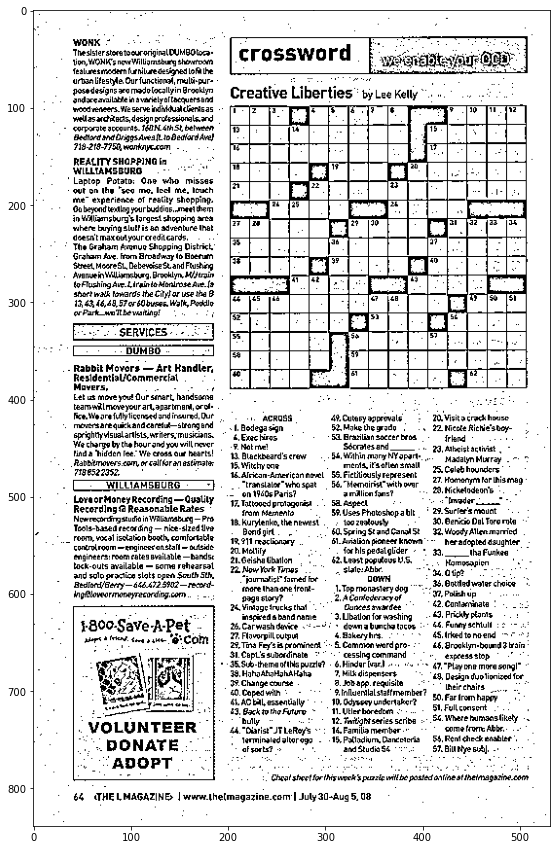

In [86]:
show_pic(th2)

## Blurring and Smoothing

In [87]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [88]:
# load image as function
def load_img():
    img = cv2.imread('DATA/bricks.jpg').astype(np.float32) / 255
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

In [89]:
# check wether it works
load_img()

array([[[0.78431374, 0.7882353 , 0.80784315],
        [0.7529412 , 0.77254903, 0.79607844],
        [0.7254902 , 0.7647059 , 0.8       ],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       [[0.8784314 , 0.88235295, 0.9019608 ],
        [0.7647059 , 0.78431374, 0.80784315],
        [0.7019608 , 0.7529412 , 0.78431374],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       [[0.85490197, 0.8666667 , 0.89411765],
        [0.6509804 , 0.6784314 , 0.70980394],
        [0.4862745 , 0.5372549 , 0.57254905],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       ...,

       [[0.8509804 , 0.83137256, 0.84705883],
        [0.84705883, 0.827451  , 0.84313726],
        [0.84313726, 0

In [90]:
# display image as function
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img)

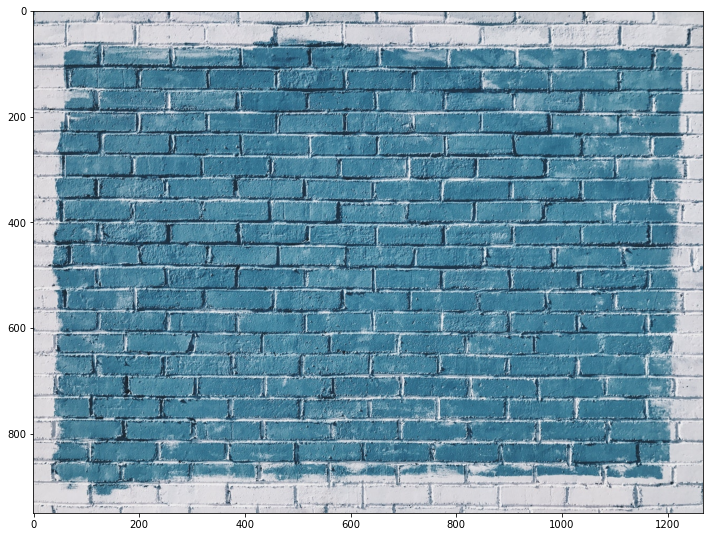

In [91]:
i = load_img()
display_img(i)

In [92]:
gamma = 8
# higher darker
# lower lighter

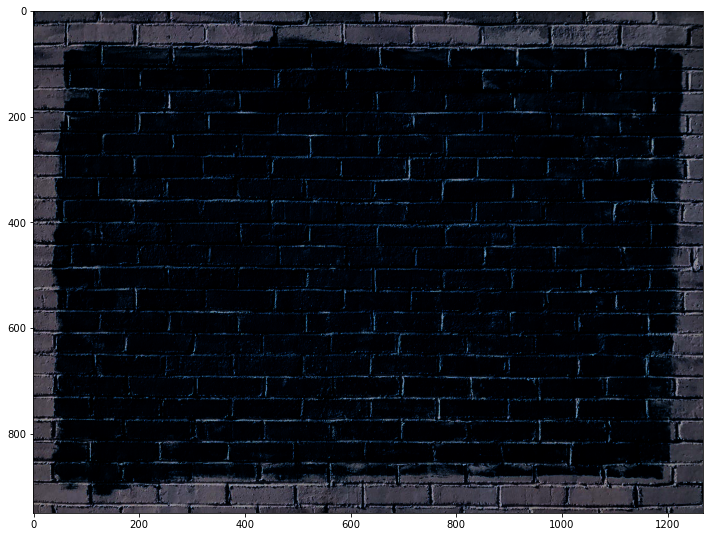

In [93]:
result = np.power(i, gamma)
# take the all pixel value of the image and raise it by the power of gamma

display_img(result)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


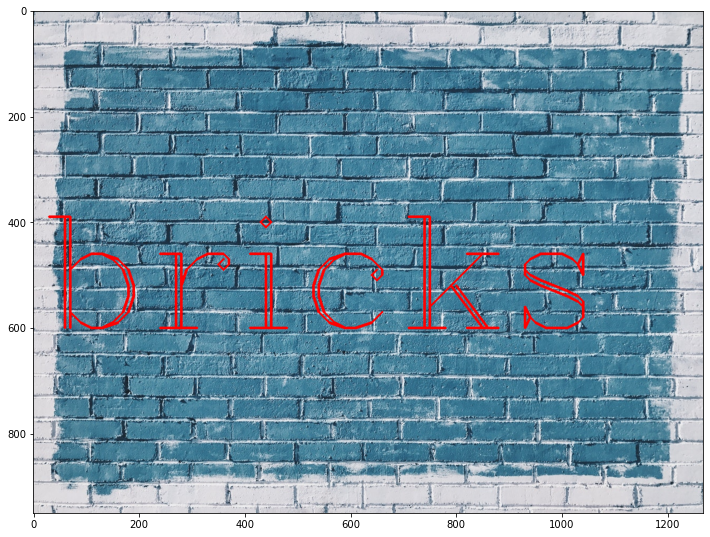

In [94]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

In [95]:
1/25

0.04

In [96]:
kernel = np.ones(shape=(5,5),dtype=np.float32)/25
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


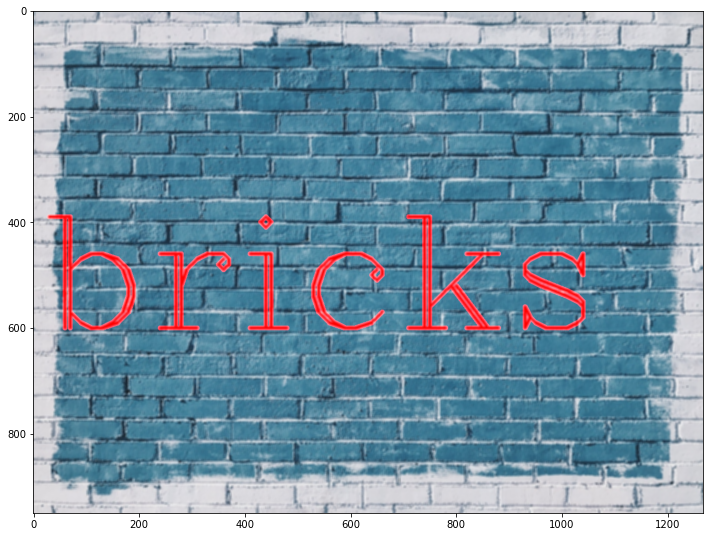

In [97]:
dst = cv2.filter2D(img,-1,kernel)
# source image
# desired depth (normally -1)
# kernel

display_img(dst)

### Averaging

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


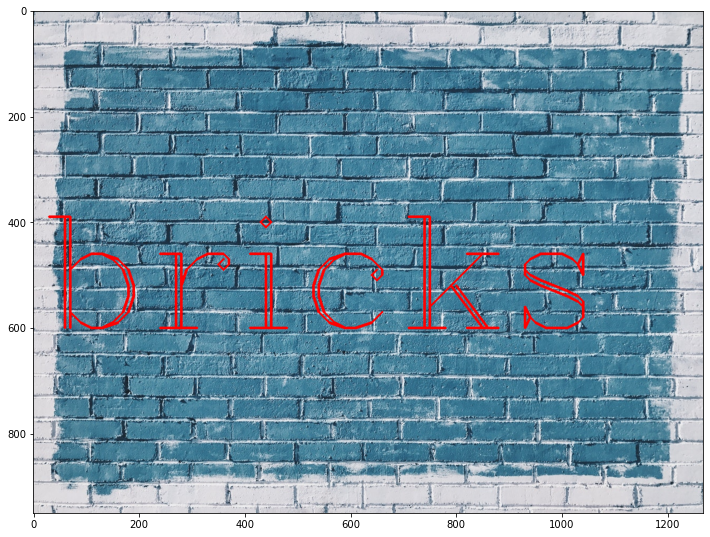

In [98]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


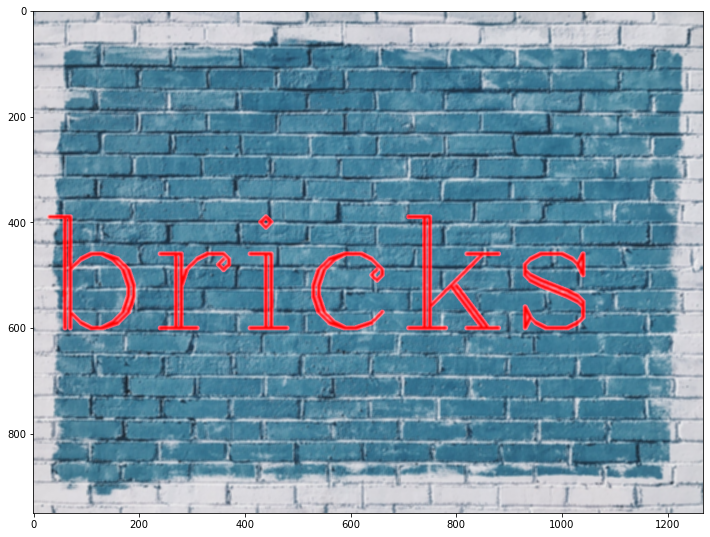

In [99]:
blurred_img = cv2.blur(img,ksize=(5,5))  # cv2 built in blur
display_img(blurred_img)

### Gaussian Blurring

In [100]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


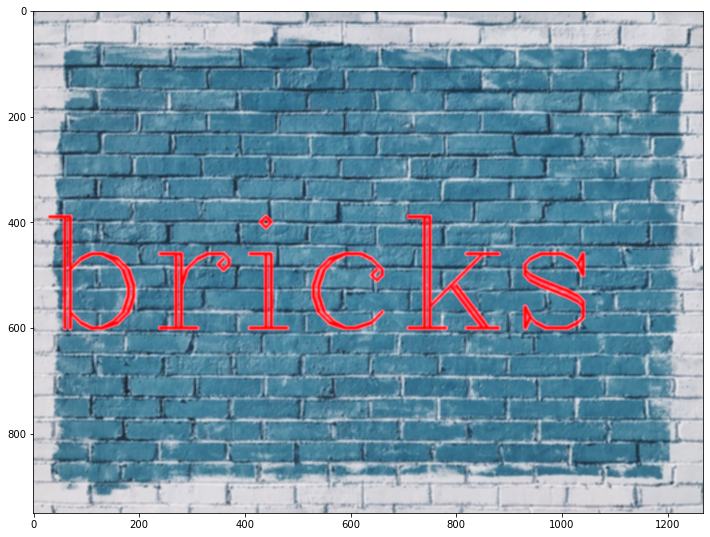

In [101]:
blurred_img = cv2.GaussianBlur(img,(5,5),10)
# source image
# kernel size
# sigma value

display_img(blurred_img)

### Median Blurring

In [102]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


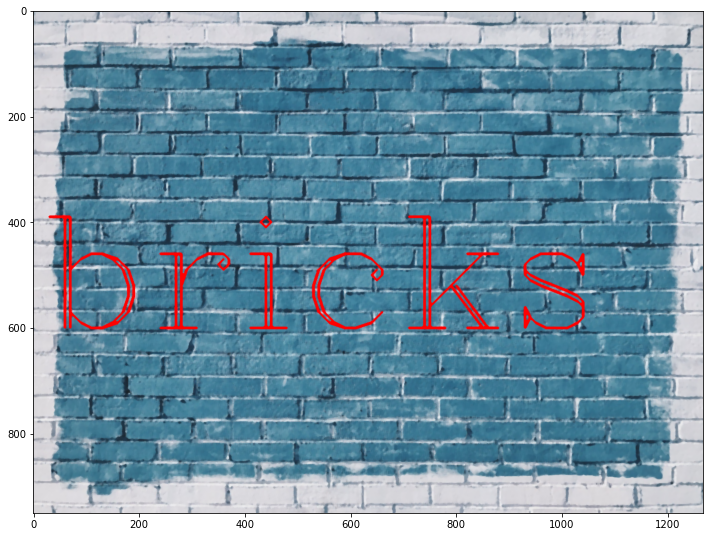

In [103]:
median = cv2.medianBlur(img,5)
# source image
# kernel (its squared kernel, so it just end up taking one argument)
# int this case 5 means 5 by 5

display_img(median)
# se the edges of the owrd isn't as blurred as before
# really good at removing noises while keeping the details intact

In [104]:
img = cv2.imread('DATA/sammy.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

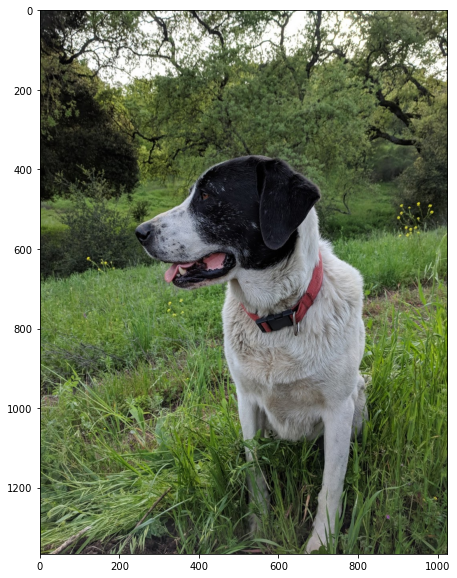

In [105]:
display_img(img)

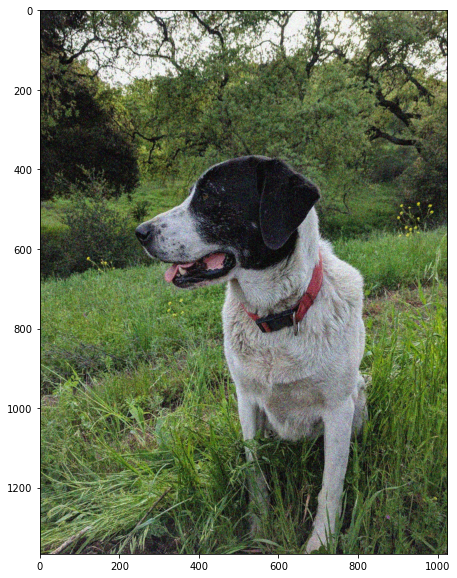

In [106]:
# noisy image
noise_img = cv2.imread('DATA/sammy_noise.jpg')
display_img(noise_img)

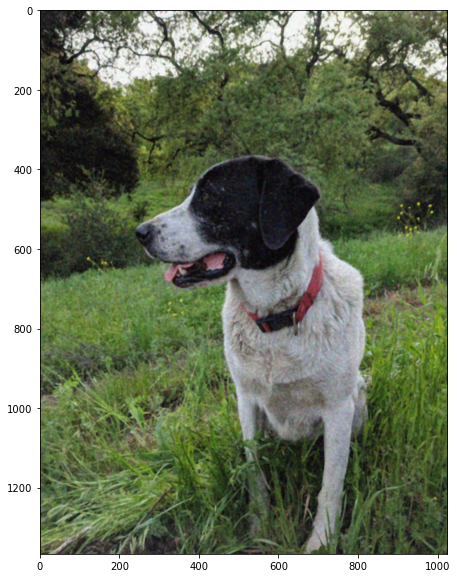

In [107]:
median = cv2.medianBlur(noise_img,5)
# removing noises using medianBlur
# 5 is good default, if needs more can be upped

display_img(median)

### Bilateral Filtering

In [108]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


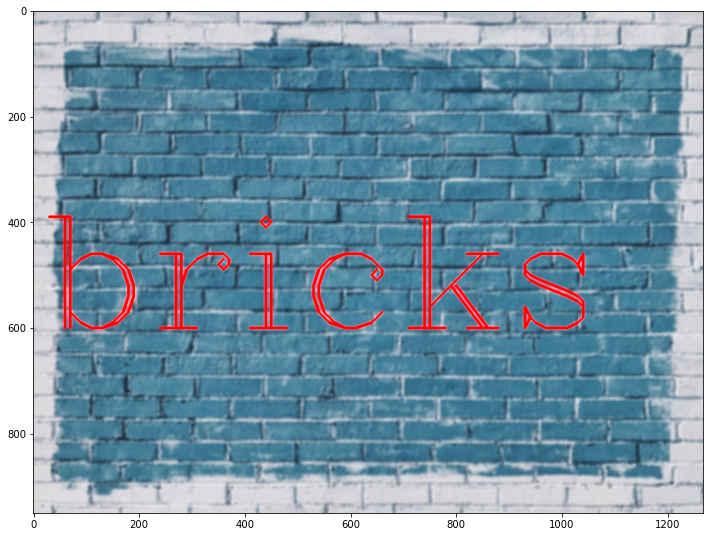

In [109]:
blur = cv2.bilateralFilter(img,9,75,75)
display_img(blur)
# kinda works like median
# removes noises and keep details intact

## Morphological Operators

In [110]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [111]:
def load_img():
    blank_img =np.zeros((600,600))
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(blank_img,text='ABCDE',org=(50,300), fontFace=font,fontScale= 5,color=(255,255,255),thickness=25,lineType=cv2.LINE_AA)
    return blank_img

In [112]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap='gray')

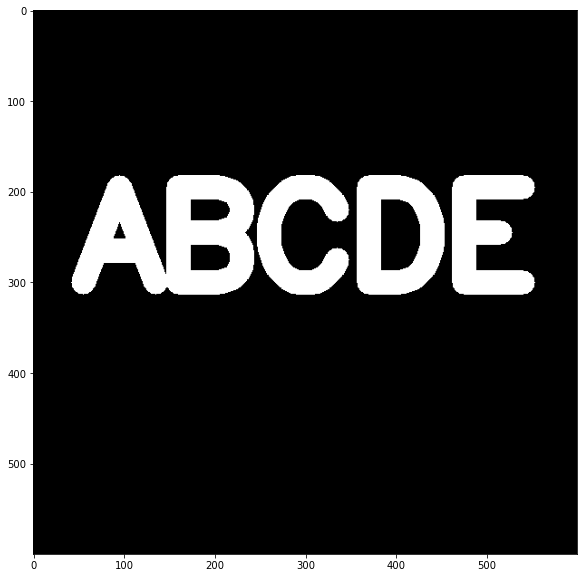

In [116]:
img = load_img()
display_img(img)

### Erosion

In [114]:
kernel = np.ones((5,5), dtype=np.uint8)
kernel

array([[1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1]], dtype=uint8)

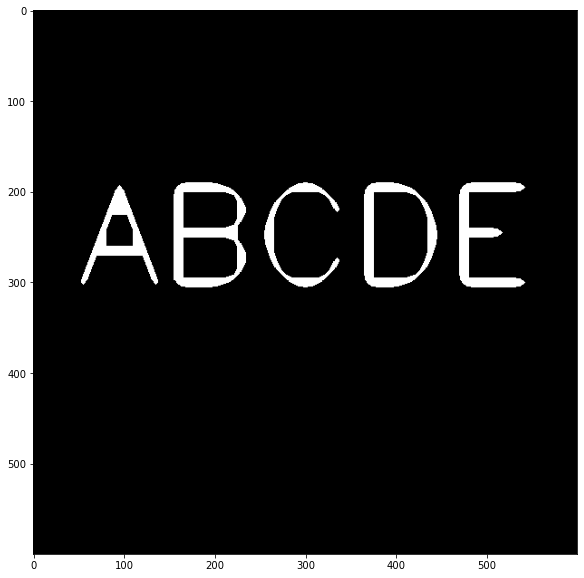

In [117]:
result = cv2.erode(img,kernel,iterations=4)
display_img(result)

### Opening

In [118]:
img = load_img()

In [119]:
# Create background noise
white_noise = np.random.randint(low=0, high=2, size=(600,600))
white_noise

array([[0, 0, 0, ..., 1, 1, 0],
       [1, 0, 1, ..., 1, 1, 1],
       [1, 0, 1, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 1, 1],
       [0, 1, 1, ..., 1, 0, 0],
       [0, 0, 1, ..., 0, 1, 0]])

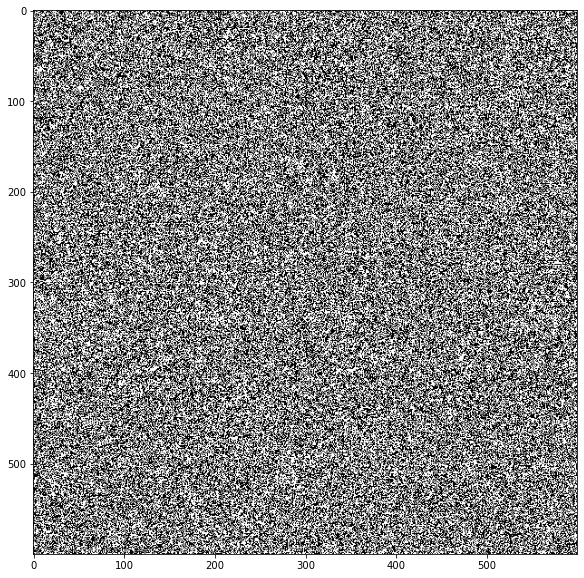

In [120]:
display_img(white_noise)

In [121]:
img.max()

255.0

In [123]:
white_noise = white_noise * 255  # multiply white noise so now it has 0 & 255 points (same scale as our oribinal img)

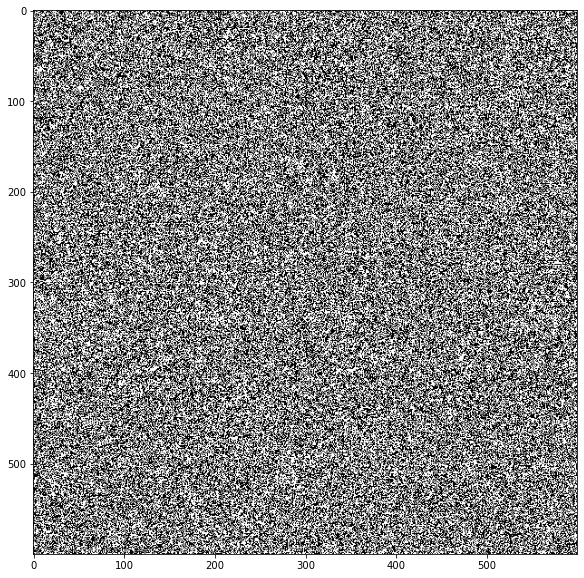

In [124]:
display_img(white_noise)

In [125]:
noise_img = white_noise + img  # we just add the noise to the original img
noise_img

array([[  0.,   0.,   0., ..., 255., 255.,   0.],
       [255.,   0., 255., ..., 255., 255., 255.],
       [255.,   0., 255., ...,   0.,   0.,   0.],
       ...,
       [  0.,   0.,   0., ...,   0., 255., 255.],
       [  0., 255., 255., ..., 255.,   0.,   0.],
       [  0.,   0., 255., ...,   0., 255.,   0.]])

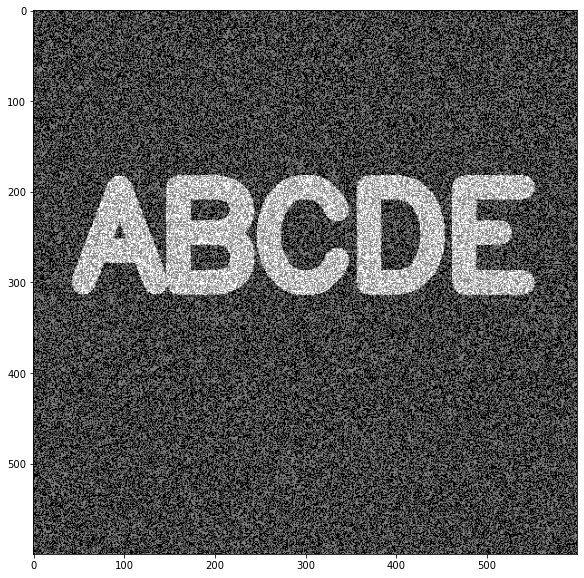

In [126]:
display_img(noise_img)

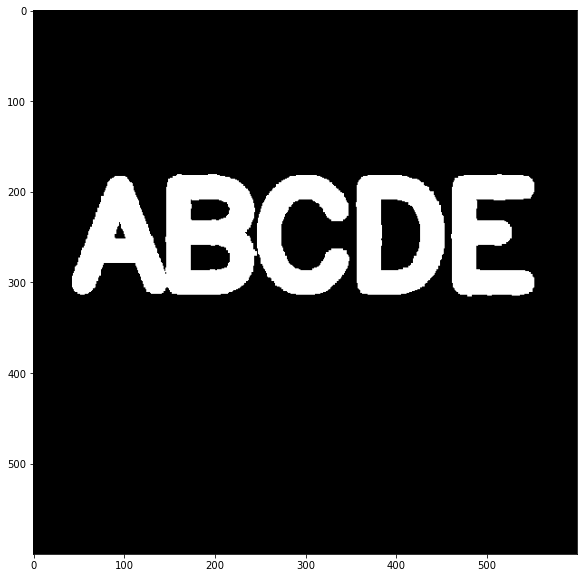

In [127]:
opening = cv2.morphologyEx(noise_img, cv2.MORPH_OPEN, kernel)
# opening == erosion followed by dilation
# opening is useful at removing background noise
display_img(opening)

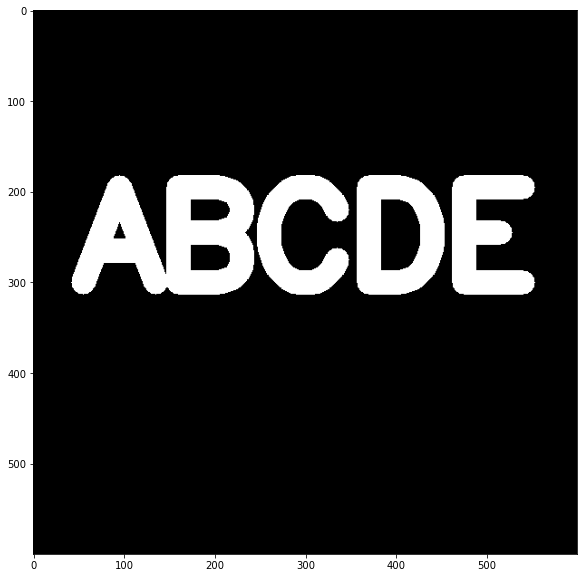

In [128]:
display_img(img)

### Closing

In [143]:
img = load_img()

In [131]:
# Creating image with foreground noise
black_noise = np.random.randint(low=0, high=2, size=(600,600))
black_noise

array([[1, 0, 0, ..., 1, 0, 0],
       [1, 0, 1, ..., 0, 0, 0],
       [1, 0, 1, ..., 1, 0, 0],
       ...,
       [1, 1, 1, ..., 0, 0, 0],
       [1, 0, 0, ..., 0, 0, 1],
       [0, 1, 1, ..., 0, 0, 0]])

In [132]:
black_noise = black_noise * -255

In [134]:
black_noise

array([[-255,    0,    0, ..., -255,    0,    0],
       [-255,    0, -255, ...,    0,    0,    0],
       [-255,    0, -255, ..., -255,    0,    0],
       ...,
       [-255, -255, -255, ...,    0,    0,    0],
       [-255,    0,    0, ...,    0,    0, -255],
       [   0, -255, -255, ...,    0,    0,    0]])

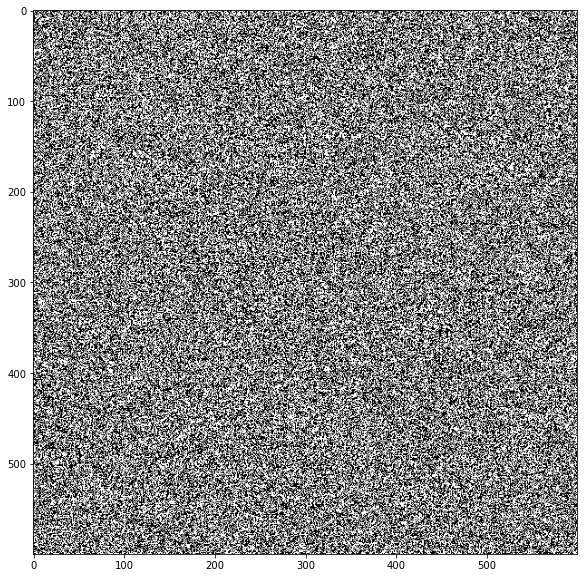

In [135]:
display_img(black_noise)

In [136]:
black_noise_img = img + black_noise
black_noise_img
# notice it has -255 value
# since it doesn't make sense to have this kind of value we need to bring back up those value to 0

array([[-255.,    0.,    0., ..., -255.,    0.,    0.],
       [-255.,    0., -255., ...,    0.,    0.,    0.],
       [-255.,    0., -255., ..., -255.,    0.,    0.],
       ...,
       [-255., -255., -255., ...,    0.,    0.,    0.],
       [-255.,    0.,    0., ...,    0.,    0., -255.],
       [   0., -255., -255., ...,    0.,    0.,    0.]])

In [137]:
black_noise_img[black_noise_img == -255] = 0
black_noise_img

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

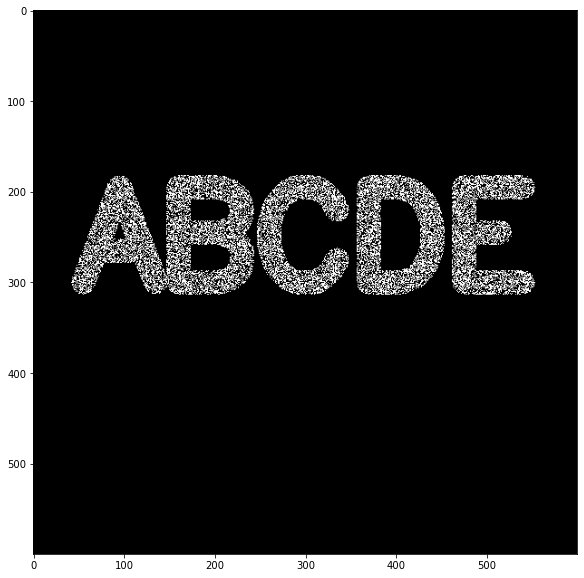

In [138]:
display_img(black_noise_img)

In [139]:
closing = cv2.morphologyEx(black_noise_img, cv2.MORPH_CLOSE, kernel)
# closing is useful at removing foreground noise
# essentially the opposite of morphological opening

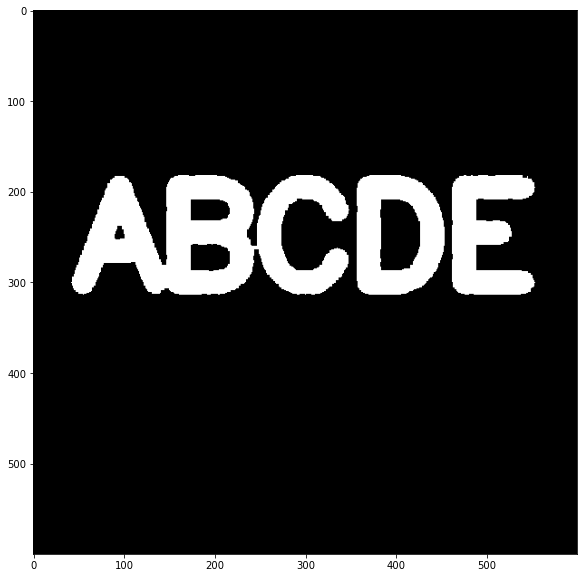

In [140]:
display_img(closing)

In [144]:
img = load_img()

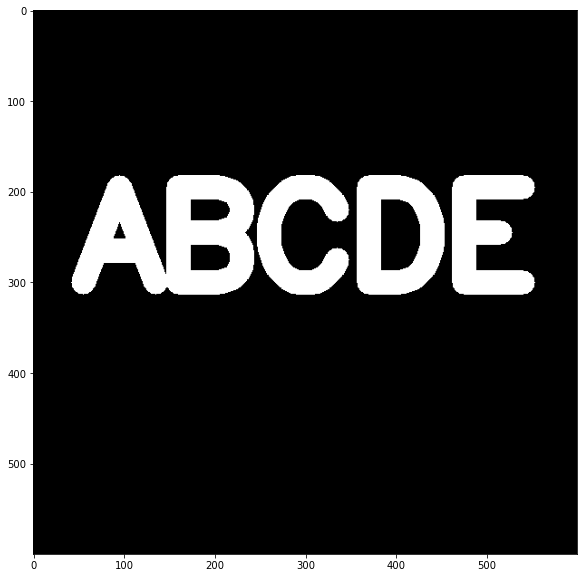

In [145]:
display_img(img)

### Gradient

In [146]:
gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
# useful as a crude form of edge detection
gradient

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

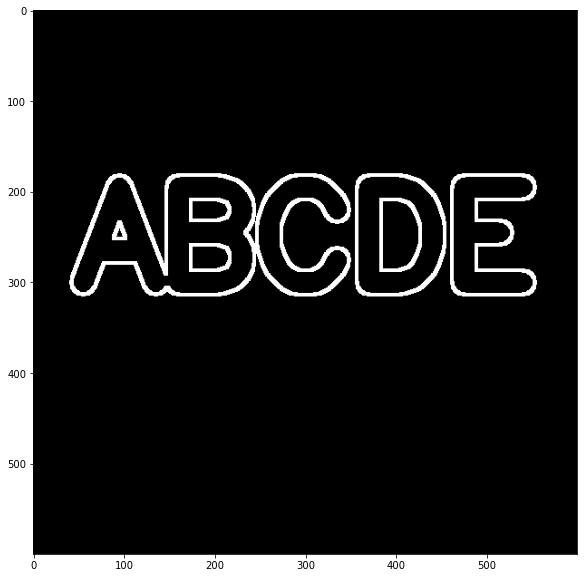

In [147]:
display_img(gradient)

## Gradients

In [148]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [149]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img, cmap='gray')

### Sobel

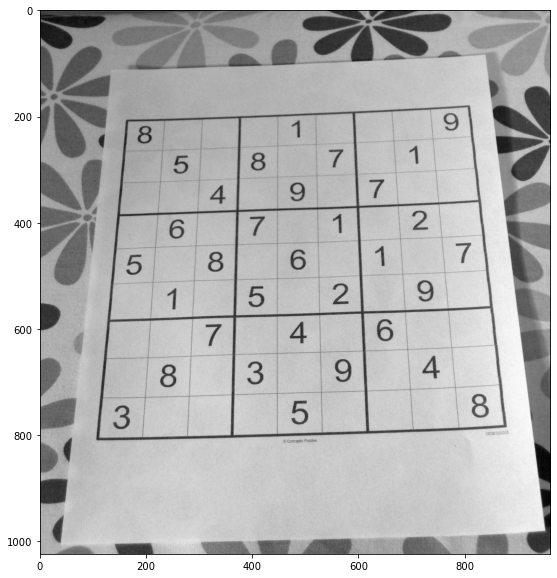

In [150]:
img = cv2.imread('DATA/sudoku.jpg', 0)
display_img(img)

In [151]:
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=5)
# source
# desired depth
# derivative x
# derivative y
# kernel size

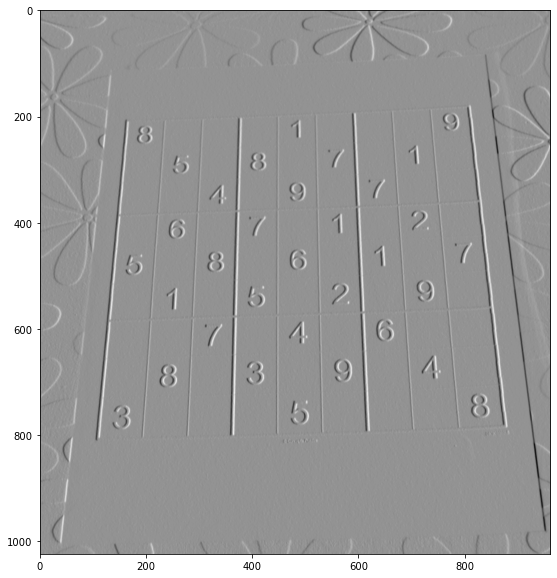

In [152]:
display_img(sobelx)

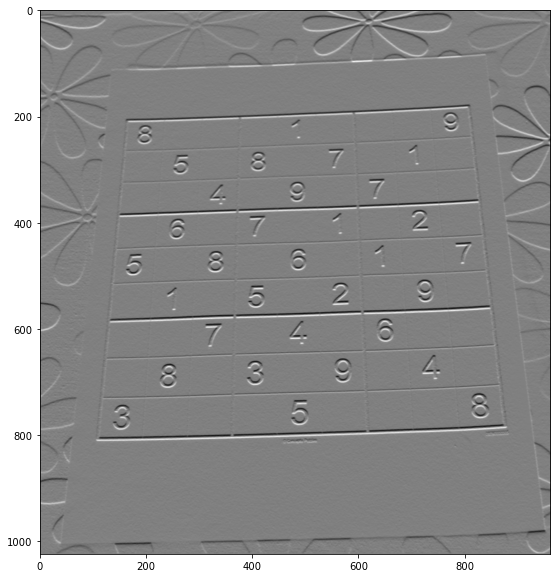

In [154]:
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=5)
display_img(sobely)

### Laplace operator

In [156]:
laplacian = cv2.Laplacian(img, cv2.CV_64F)

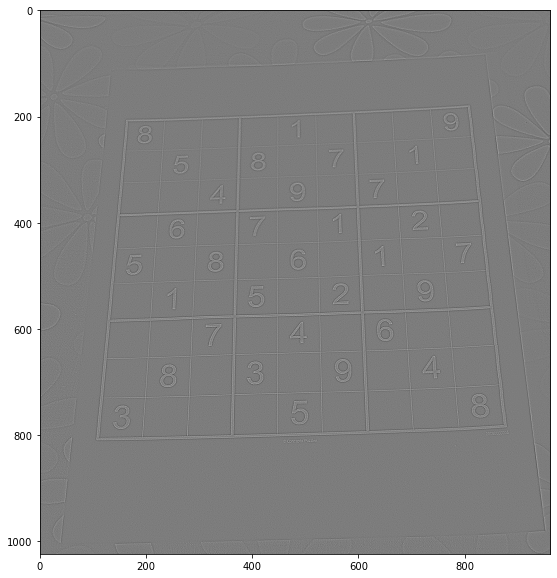

In [157]:
display_img(laplacian)

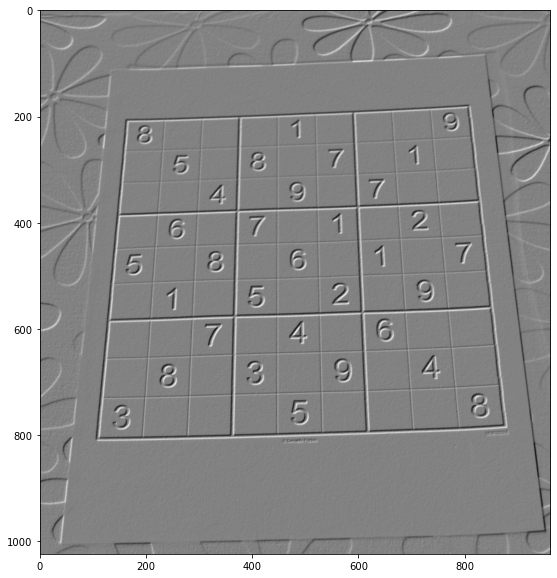

In [158]:
# Try to blend sobelx and sobely
blended = cv2.addWeighted(src1=sobelx, alpha=0.5, src2=sobely, beta=0.5, gamma=0)
display_img(blended)

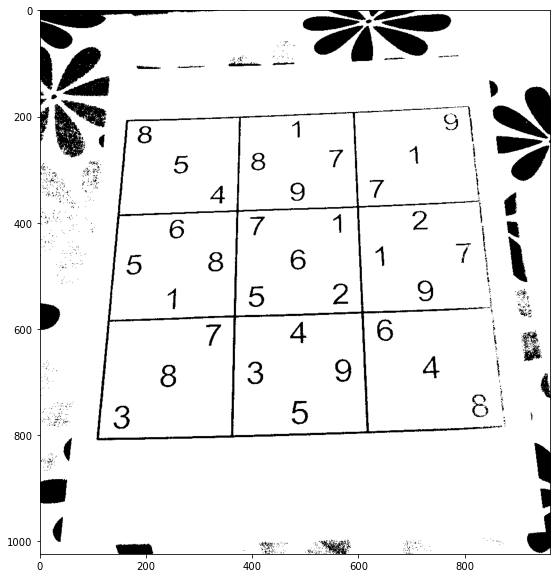

In [159]:
# Try to put threshold
ret,th1 = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
display_img(th1)

In [160]:
# try to do morphological on it
kernel = np.ones((4,4), np.uint8)

In [161]:
gradient = cv2.morphologyEx(blended, cv2.MORPH_GRADIENT, kernel)

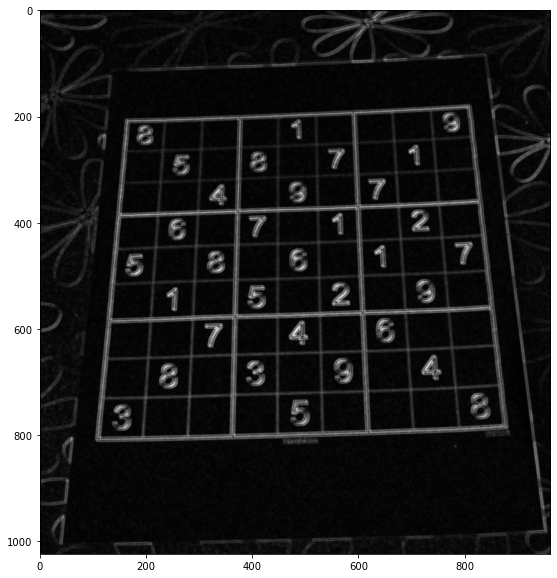

In [162]:
display_img(gradient)

## Histograms

In [163]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [164]:
dark_horse = cv2.imread('DATA/horse.jpg')  # ORIGINAL BGR OPENCV
show_horse = cv2.cvtColor(dark_horse, cv2.COLOR_BGR2RGB)  # CONVERTED TO RGB FOR SHOW

rainbow = cv2.imread('DATA/rainbow.jpg')
show_rainbow =cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

blue_bricks = cv2.imread('DATA/bricks.jpg')
show_bricks = cv2.cvtColor(blue_bricks, cv2.COLOR_BGR2RGB)

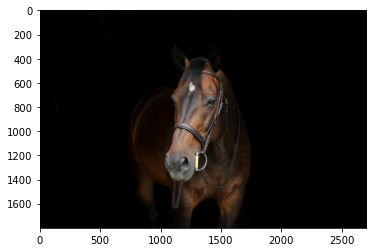

In [165]:
plt.imshow(show_horse)

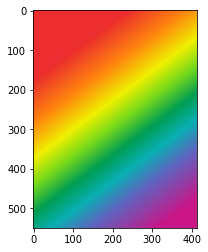

In [166]:
plt.imshow(show_rainbow)

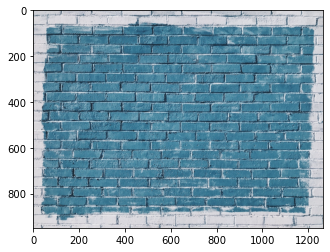

In [167]:
plt.imshow(show_bricks)

### Calculate the histogram value

In [169]:
hist_values = cv2.calcHist([blue_bricks], channels=[0], mask=None, histSize=[256], ranges=[0,256])
# calculate blue channel
# opencv == bgr, so channels=[0] == blue

In [170]:
hist_values.shape

(256, 1)

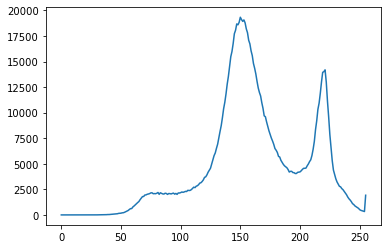

In [171]:
plt.plot(hist_values)

In [172]:
hist_values = cv2.calcHist([dark_horse], channels=[0], mask=None, histSize=[256], ranges=[0,256])

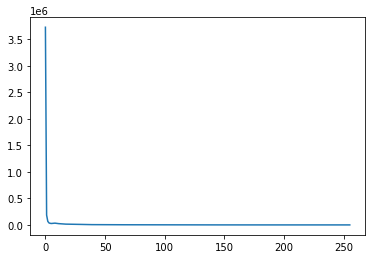

In [174]:
plt.plot(hist_values)

In [175]:
img = blue_bricks

Text(0.5, 1.0, 'HISTOGRAM FOR BLUE BRICKS')

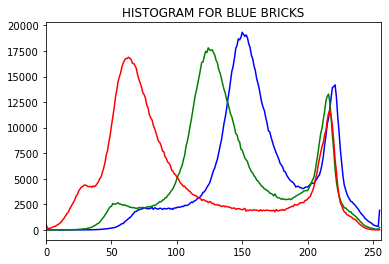

In [177]:
color = ('b', 'g', 'r')

for i, col in enumerate(color):
    histr = cv2.calcHist([img], [i], None, [256], [0,256])
    plt.plot(histr,color=col)
    plt.xlim([0,256])
    
plt.title('HISTOGRAM FOR BLUE BRICKS')

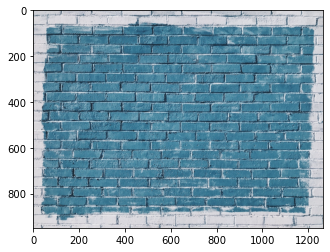

In [178]:
plt.imshow(show_bricks)

In [179]:
img = dark_horse

Text(0.5, 1.0, 'HISTOGRAM FOR DARK HORSE')

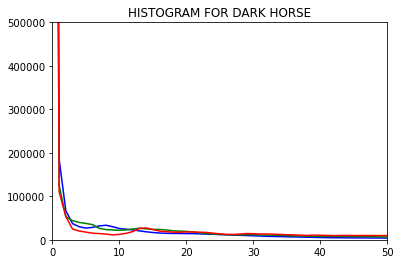

In [184]:
color = ('b', 'g', 'r')

for i, col in enumerate(color):
    histr = cv2.calcHist([img], [i], None, [256], [0,256])
    plt.plot(histr,color=col)
    plt.xlim([0,50])
    plt.ylim([0, 500000])
    
plt.title('HISTOGRAM FOR DARK HORSE')

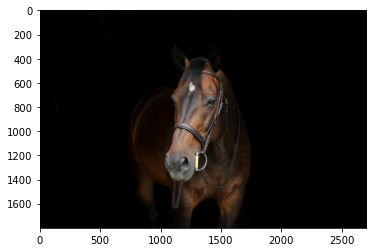

In [181]:
plt.imshow(show_horse)

In [185]:
dark_horse.shape

(1800, 2700, 3)

In [186]:
# How many pixels in dark_horse
1800*2700*3

14580000

## Histograms - Part Two - Histogram Equalization

In [187]:
rainbow = cv2.imread('DATA/rainbow.jpg')
show_rainbow = cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

In [188]:
img = rainbow

In [189]:
img.shape

(550, 413, 3)

In [190]:
img.shape[:2]

(550, 413)

In [191]:
mask = np.zeros(img.shape[:2], np.uint8)
# we only mask ceratin dimension hence img.shape[:2]
# remember we do not want to mask certain colors out

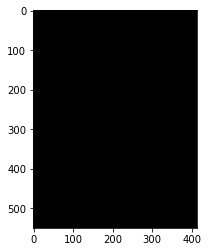

In [192]:
plt.imshow(mask, cmap='gray')
# create empty black

In [193]:
mask[300:400, 100:400] = 255
# filling your region of interest white

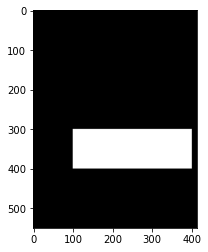

In [194]:
plt.imshow(mask, cmap='gray')

In [195]:
masked_img = cv2.bitwise_and(img, img, mask=mask)
# for actual histogram calculation

In [196]:
show_masked_img = cv2.bitwise_and(show_rainbow, show_rainbow, mask=mask)
# for visualization purposes

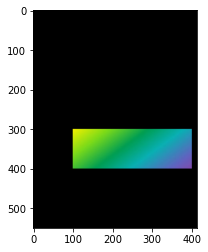

In [197]:
plt.imshow(show_masked_img)

In [199]:
hist_mask_values_red = cv2.calcHist([rainbow], channels=[2], mask=mask, histSize=[256], ranges=[0,256])

In [200]:
hist_values_red = cv2.calcHist([rainbow], channels=[2], mask=None, histSize=[256], ranges=[0,256])

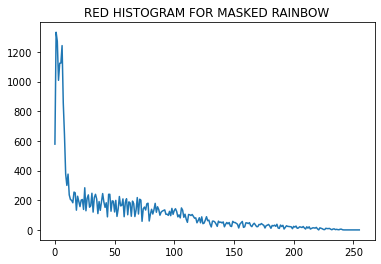

In [203]:
plt.plot(hist_mask_values_red)
plt.title('RED HISTOGRAM FOR MASKED RAINBOW');

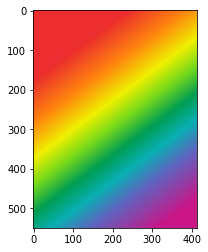

In [198]:
plt.imshow(show_rainbow)

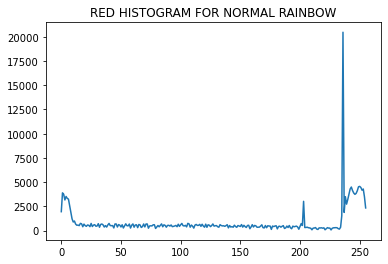

In [204]:
plt.plot(hist_values_red)
plt.title('RED HISTOGRAM FOR NORMAL RAINBOW');

## Histograms - Part Three - Histogram Equalization

In [205]:
gorilla = cv2.imread('DATA/gorilla.jpg', 0)

In [210]:
def display(img, cmap=None):
    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap)

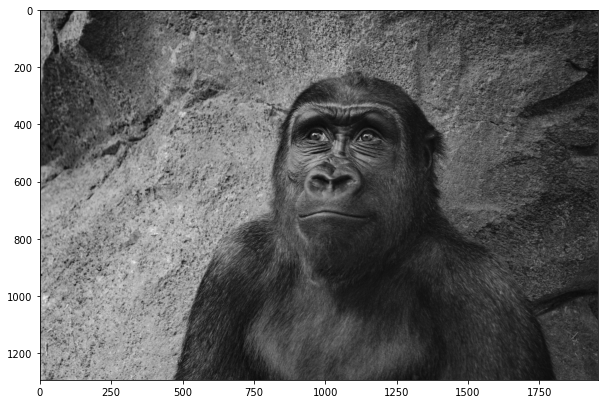

In [211]:
display(gorilla, cmap='gray')

In [212]:
gorilla.shape

(1295, 1955)

In [213]:
hist_values = cv2.calcHist([gorilla], channels=[0], mask=None, histSize=[256], ranges=[0,256])

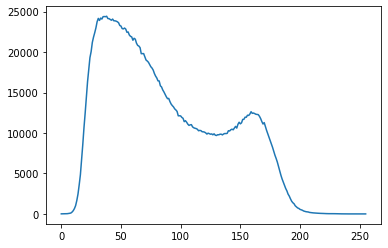

In [214]:
plt.plot(hist_values)

In [215]:
eq_gorilla = cv2.equalizeHist(gorilla)

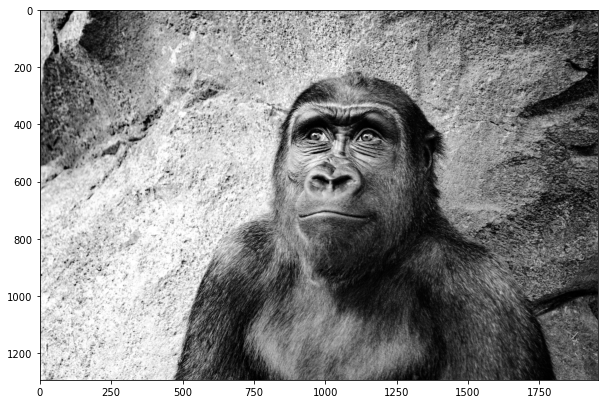

In [216]:
display(eq_gorilla, cmap='gray')

In [217]:
hist_values = cv2.calcHist([eq_gorilla], channels=[0], mask=None, histSize=[256], ranges=[0,256])

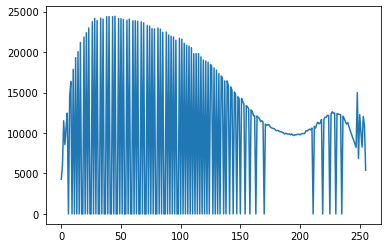

In [218]:
plt.plot(hist_values)

### Equalize colored picture

In [221]:
color_gorilla = cv2.imread('DATA/gorilla.jpg')

In [222]:
show_gorilla = cv2.cvtColor(color_gorilla, cv2.COLOR_BGR2RGB)

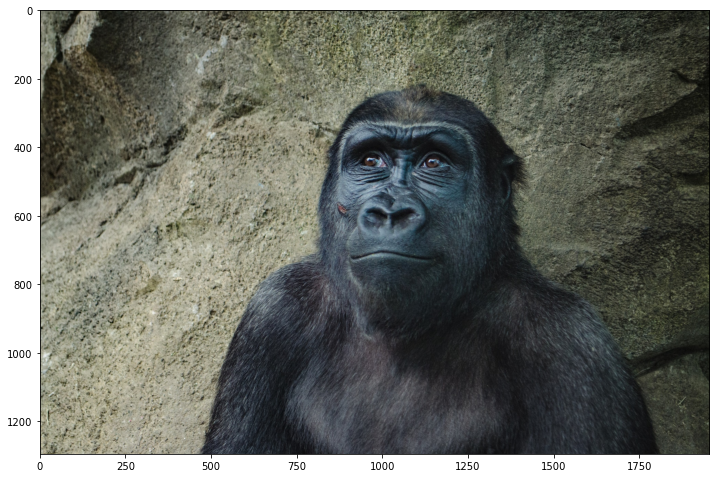

In [223]:
display_img(show_gorilla)

In [224]:
hsv = cv2.cvtColor(color_gorilla, cv2.COLOR_BGR2HSV)
# Create hsv version of gorilla
# need to convert to hsv because of how equalization works

In [225]:
hsv[:,:,2].max()

255

In [226]:
hsv[:,:,2].min()

1

In [227]:
hsv[:,:,2] = cv2.equalizeHist(hsv[:,:,2])

In [228]:
eq_color_gorilla = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)

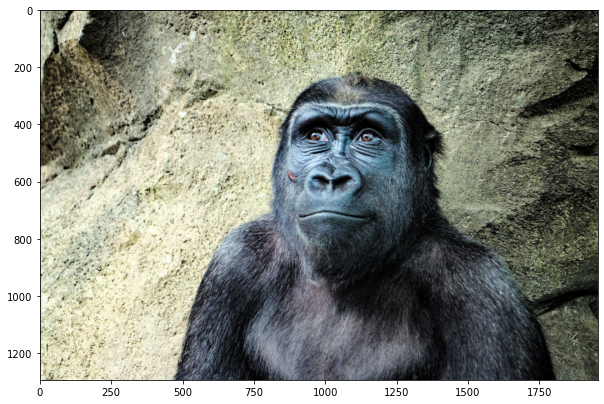

In [229]:
display(eq_color_gorilla)

## Image Processing Assesment Overview